# Graded Challenge 4 - Phase 1
Muhammad Ikhsan Rahman Hakim - FTDS001


This case requires to develop a customer segmentation to define marketing strategy. The
sample Dataset summarizes the usage behavior of about 9000 active credit card holders during the last 6 months. The file is at a customer level with 18 behavioral variables.

**Following is the Data Dictionary for Credit Card dataset :**

- CUSTID : Identification of Credit Card holder (Categorical)
- BALANCE : Balance amount left in their account to make purchases (
- BALANCEFREQUENCY : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
- PURCHASES : Amount of purchases made from account
- ONEOFFPURCHASES : Maximum purchase amount done in one-go
- INSTALLMENTSPURCHASES : Amount of purchase done in installment
- CASHADVANCE : Cash in advance given by the user
- PURCHASESFREQUENCY : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
- ONEOFFPURCHASESFREQUENCY : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)
- PURCHASESINSTALLMENTSFREQUENCY : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
- CASHADVANCEFREQUENCY : How frequently the cash in advance being paid
- CASHADVANCETRX : Number of Transactions made with "Cash in Advanced"
- PURCHASESTRX : Numbe of purchase transactions made
- CREDITLIMIT : Limit of Credit Card for user
- PAYMENTS : Amount of Payment done by user
- MINIMUM_PAYMENTS : Minimum amount of payments made by user
- PRCFULLPAYMENT : Percent of full payment paid by user
- TENURE : Tenure of credit card service for user

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering as AC
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score,silhouette_samples
from sklearn.preprocessing import StandardScaler

%matplotlib inline

# Data Loading

In [2]:
# we can see all the columns
pd.set_option('display.max_columns', 100)

# to make this notebook's output stable across runs
np.random.seed(42)

In [3]:
rawdf = pd.read_csv('CC GENERAL.csv')

# Dataset Exploration

In [4]:
rawdf.shape

(8950, 18)

In [45]:
rawdf.head(5)

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster_id,cluster_dbs,cluster_agg
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,1,0,1
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0,-1,2
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,1,-1,0
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12,1,-1,1
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1,0,1


In [6]:
rawdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [7]:
rawdf.describe().T

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.0,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.13856
BALANCE_FREQUENCY,8950.0,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.00000
PURCHASES,8950.0,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.57000
ONEOFF_PURCHASES,8950.0,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.25000
INSTALLMENTS_PURCHASES,8950.0,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.00000
CASH_ADVANCE,8950.0,978.871112,2097.163877,0.000000,0.000000,0.000000,1113.821139,47137.21176
PURCHASES_FREQUENCY,8950.0,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.00000
ONEOFF_PURCHASES_FREQUENCY,8950.0,0.202458,0.298336,0.000000,0.000000,0.083333,0.300000,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,8950.0,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.00000
CASH_ADVANCE_FREQUENCY,8950.0,0.135144,0.200121,0.000000,0.000000,0.000000,0.222222,1.50000


# Data Cleaning

In [8]:
rawdf.duplicated().any()

False

In [9]:
rawdf.isnull().sum().sort_values(ascending=False)

MINIMUM_PAYMENTS                    313
CREDIT_LIMIT                          1
CUST_ID                               0
BALANCE                               0
PRC_FULL_PAYMENT                      0
PAYMENTS                              0
PURCHASES_TRX                         0
CASH_ADVANCE_TRX                      0
CASH_ADVANCE_FREQUENCY                0
PURCHASES_INSTALLMENTS_FREQUENCY      0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_FREQUENCY                   0
CASH_ADVANCE                          0
INSTALLMENTS_PURCHASES                0
ONEOFF_PURCHASES                      0
PURCHASES                             0
BALANCE_FREQUENCY                     0
TENURE                                0
dtype: int64

In [10]:
rawdf['CREDIT_LIMIT'].fillna(rawdf['CREDIT_LIMIT'].mean(), inplace=True)
rawdf['MINIMUM_PAYMENTS'].fillna(rawdf['MINIMUM_PAYMENTS'].mean(), inplace=True)

# Data Exploration (EDA)

In [11]:
# set plot style for EDA
plt.style.use('fivethirtyeight')

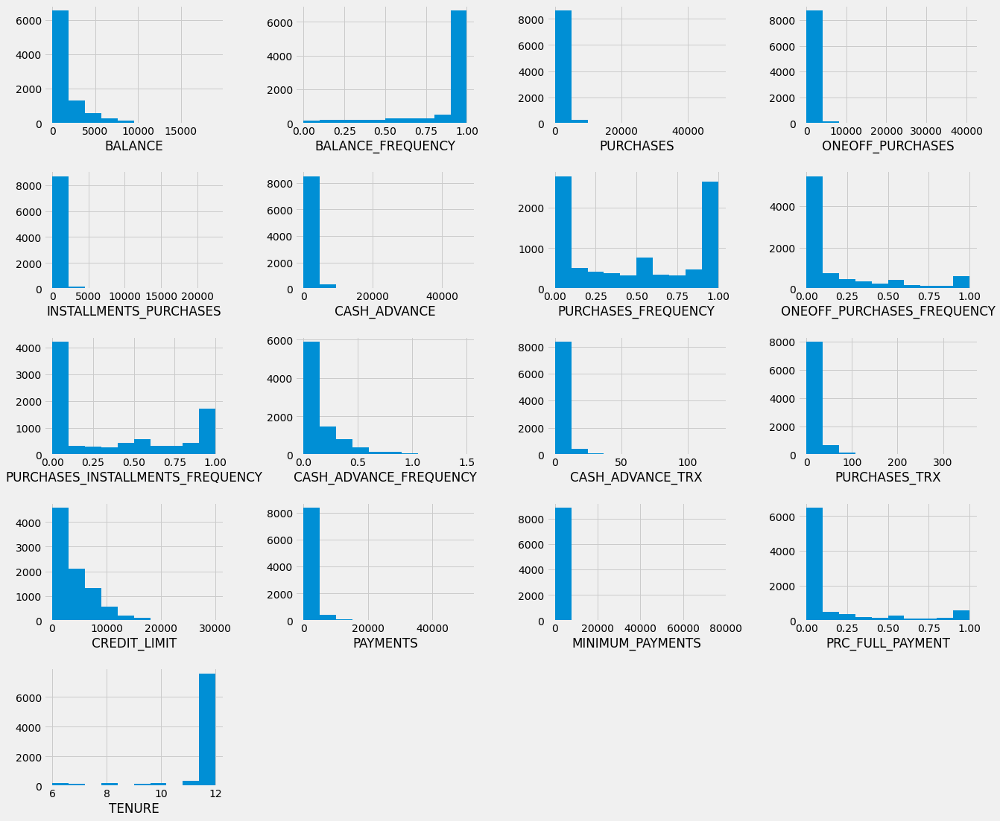

In [12]:
fig = plt.figure(figsize=(20, 18))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
for i in range(1, len(rawdf.columns)):
    ax = fig.add_subplot(5, 4, i)
    ax.hist(rawdf[rawdf.columns[i]])
    #sns.histplot(rawdf[rawdf.columns[i]])
    plt.xlabel(rawdf.columns[i])

Dari hasil plot dataset diatas, dapat terlihat bahwa banyak dari distribusi data yang tidak normal atau *skewed* dan rata-rata *skewed* ke kanan. Ini dapat dimaklumi dari kumpulan data seperti ini karena akan selalu ada beberapa pelanggan yang melakukan jumlah transaksi yang sangat tinggi. Antara lain :
- Pada kolom Credit_Limit, Payments, dan Minimum_Payments distribusi data tertarik ke kanan karena ada pelanggan yang memiliki kredit limit dan jumlah pembayaran yang tinggi.
- Hal yang sama juga terjadi pada kolom Purchases dan Installment Purchases.

Dan dapat dilihat juga di kolom Balance Frequency, rata-rata nilai datanya ada pada angka 1 yakni menunjukkan bahwa akun-akun nasabah masih banyak yang aktif karena terdeteksi seringnya pembaruan(update) saldo.

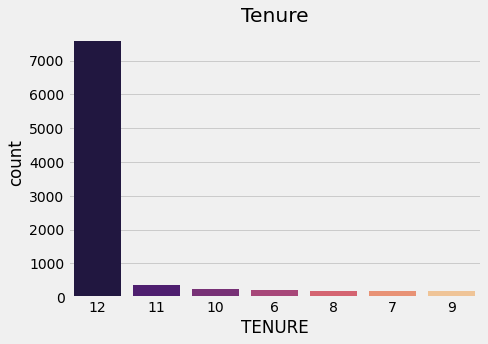

In [13]:
plt.figure(figsize = (7, 5))
sns.countplot(
    x = rawdf["TENURE"],
    order = rawdf["TENURE"].value_counts().sort_values(ascending = False).index,
    palette = "magma"
)
plt.title("Tenure", fontweight = 20)

plt.tight_layout()
plt.show()

Rata-rata kebanyakan nasabah memilih jangka waktu tenor kredit yang paling panjang yakni 12.

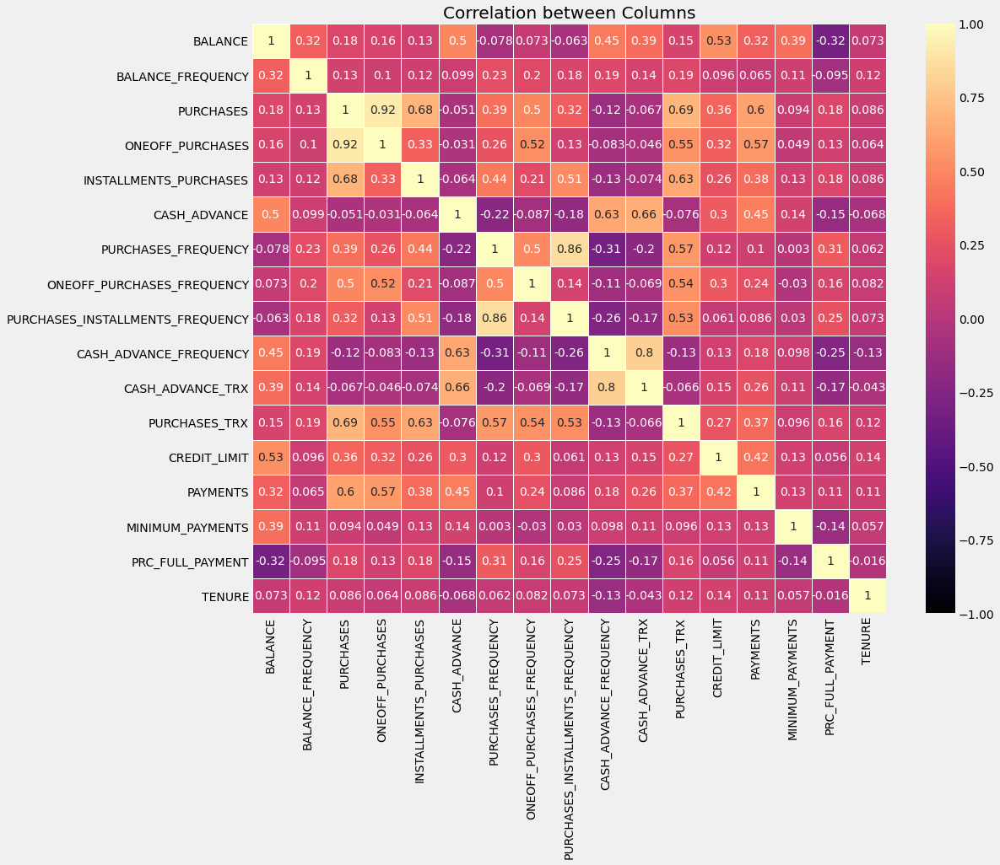

In [14]:
plt.figure(figsize=(15,12))
sns.heatmap(rawdf.corr(), vmin=-1, vmax=1, cmap='magma', annot=True, linewidths=.9)
plt.title("Correlation between Columns")
plt.show()

Visualisasi Heatmap diatas menunjukkan korelasi antar kolom pada dataset. Saat nilai korelasi positif dan > 0.5 maka jika salah satu kolom nilainya naik kolom yang berkorelasi dengannya pun ikut naik. Sebagai contoh dari heatmap ini adalah kolom Purchase. Kolom Purchase memliki nilai korelasi positif > 0.5 pada beberapa kolom yakni oneoff_purchases, installment_purchases, oneoff_purchases_frequency, purchases_trx dan payments. Sehingga jika nilai kolom Purchases naik maka nilai kolom-kolom tersebut juga naik.

# Data Preprocessing

## PCA

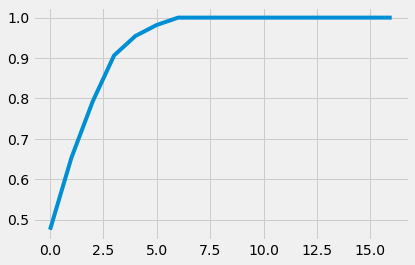

In [15]:
num_df = rawdf.drop(columns=['CUST_ID'])

pca=PCA(whiten=True)
pca.fit(num_df)
cumsum = np.cumsum(pca.explained_variance_ratio_)

plt.figure()
plt.plot(cumsum)

Dari hasil plot dapat terlihat secara kasar, bahwa hanya dengan 3 kolom (features) saja sudah mewakili kurang lebih 90% dari data asli. 

In [16]:
# mengambil 90% dari data asli
pca=PCA(n_components=0.90, whiten=True)
pca.fit(num_df)

print('Jumlah kolom untuk mendapatkan 90% dari data asli: ', pca.n_components_)
print(np.sum(pca.explained_variance_ratio_))

Jumlah kolom untuk mendapatkan 90% dari data asli:  4
0.9064713897064198


Ternyata untuk mewakili 90% dari keseluruhan data dibutuhkan 4 features/kolom/n_components.

## Scaling

In [17]:
scaler = StandardScaler()
num_df_std = scaler.fit_transform(num_df)

<AxesSubplot:>

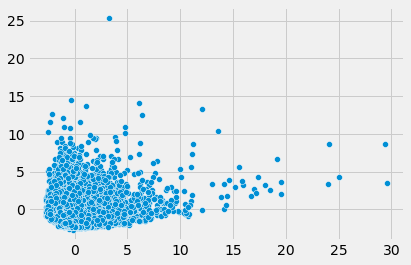

In [18]:
# transform data with PCA and plot it

df_2D = PCA(n_components=4).fit_transform(num_df_std)
sns.scatterplot(x=df_2D[:,0],y=df_2D[:,1])

# Model

## K-Means

In [19]:
# n_clusters berdasarkan PCA
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans.fit(df_2D)

KMeans(n_clusters=4, random_state=42)

## DBScan

In [20]:
dbs = DBSCAN(eps=1, min_samples=300)
dbs.fit(df_2D)

DBSCAN(eps=1, min_samples=300)

## Agglomerative Clustering

In [21]:
agg = AC(n_clusters=4, linkage="ward").fit(df_2D)

# Model Evaluation

## K-Means

<AxesSubplot:>

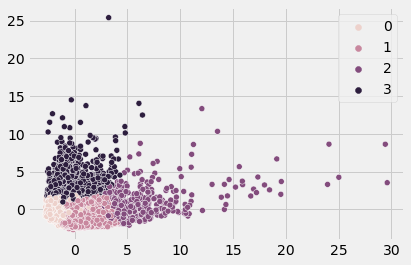

In [22]:
sns.scatterplot(x=df_2D[:,0],y=df_2D[:,1],hue=kmeans.labels_)

Hasil Scatter plot K-Means dengan n_clusters=4

### Elbow Method

Text(0, 0.5, 'Inertia')

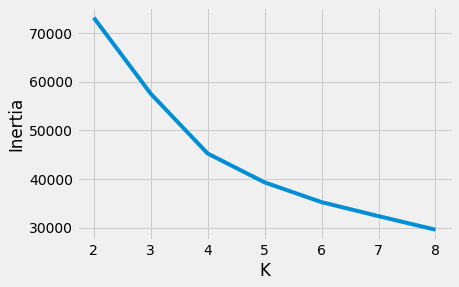

In [23]:
K =[2,3,4,5,6,7,8]
inertia = [KMeans(n_clusters=i).fit(df_2D).inertia_ for i in K]

plt.plot(K, inertia)
plt.xlabel('K')
plt.ylabel('Inertia')

Dari Elbow Method, secara kasar dapat terlihat jumlah optimal cluster (K) adalah 4. Masih sejalan dengan PCA sebelumnya.

### Silhouette Method

In [24]:
def plot_silhouette(range_n_clusters,X):
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

For n_clusters = 2 The average silhouette_score is : 0.3060991634621211
For n_clusters = 3 The average silhouette_score is : 0.34387260263930336
For n_clusters = 4 The average silhouette_score is : 0.3226329575823544
For n_clusters = 5 The average silhouette_score is : 0.3206355870019319


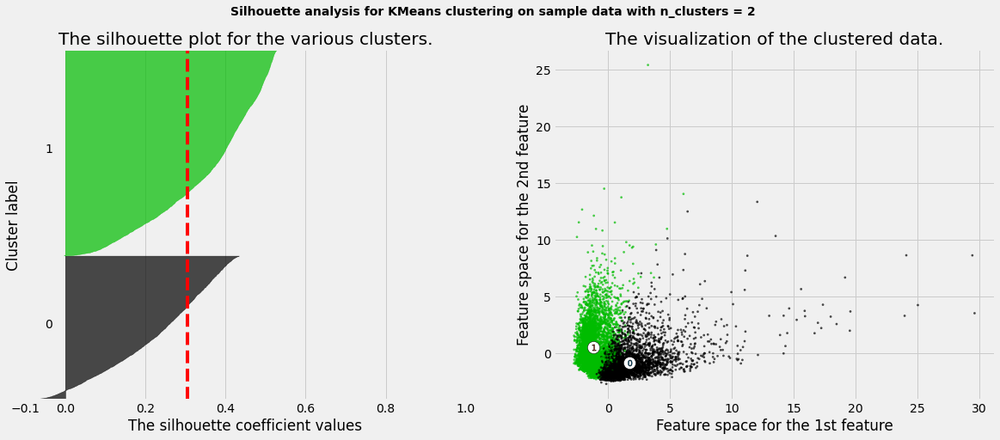

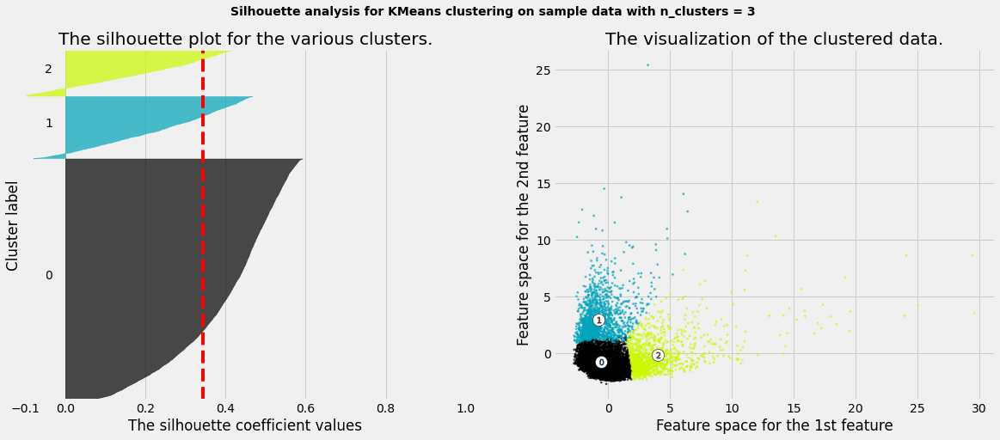

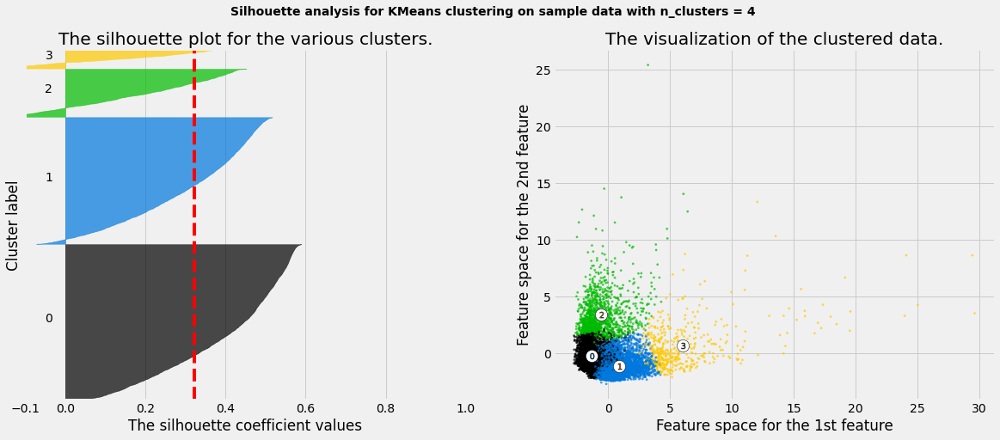

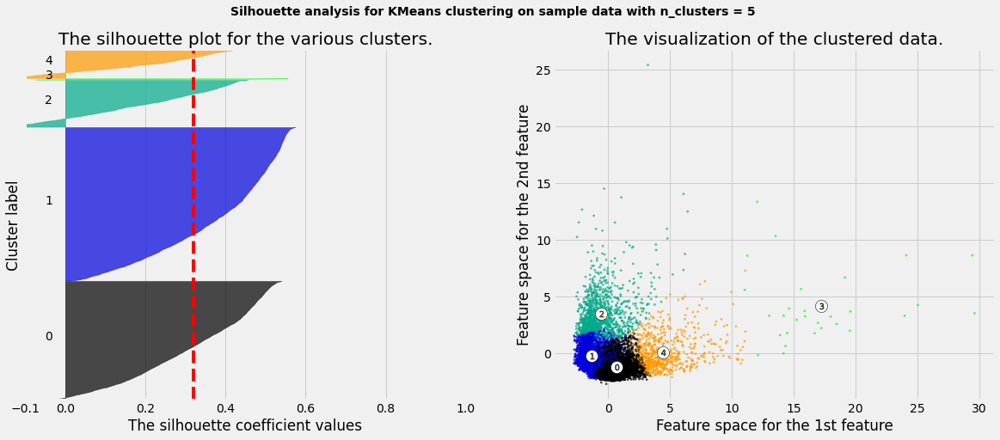

In [47]:
K =[2,3,4,5]
plot_silhouette(K, df_2D)

Text(0, 0.5, 'Silhouette Score')

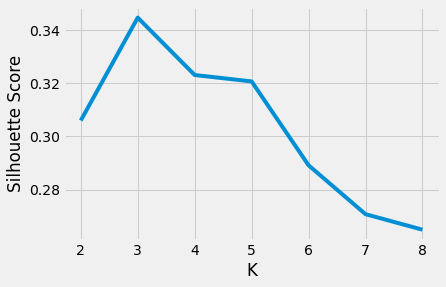

In [26]:
# plot hasil skor silhouette
K = [2,3,4,5,6,7,8]

s_score=[silhouette_score(df_2D, KMeans(n_clusters=i).fit(df_2D).labels_) for i in K]
plt.plot(K,s_score)
plt.xlabel('K')
plt.ylabel('Silhouette Score')

Namun ternyata setelah di cek dengan silhouette_score, cluster yang optimal adalah 3 dengan skor 0.34.

*Catatan: Silhouette score semakin mendekati angka 1 semakin baik. Cluster terpisah dan dapat dibedakan dengan baik.*

## DBScan

In [27]:
def plot_dbscan(dbscan, X, size, show_xlabels=True, show_ylabels=True):
    core_mask = np.zeros_like(dbscan.labels_, dtype=bool)
    core_mask[dbscan.core_sample_indices_] = True
    anomalies_mask = dbscan.labels_ == -1
    non_core_mask = ~(core_mask | anomalies_mask)

    cores = dbscan.components_
    anomalies = X[anomalies_mask]
    non_cores = X[non_core_mask]
    
    plt.scatter(cores[:, 0], cores[:, 1],
                c=dbscan.labels_[core_mask], marker='o', s=size, cmap="Paired")
    plt.scatter(cores[:, 0], cores[:, 1], marker='*', s=20, c=dbscan.labels_[core_mask])
    plt.scatter(anomalies[:, 0], anomalies[:, 1],
                c="r", marker="x", s=100)
    plt.scatter(non_cores[:, 0], non_cores[:, 1], c=dbscan.labels_[non_core_mask], marker=".")
    if show_xlabels:
        plt.xlabel("$x_1$", fontsize=14)
    else:
        plt.tick_params(labelbottom=False)
    if show_ylabels:
        plt.ylabel("$x_2$", fontsize=14, rotation=0)
    else:
        plt.tick_params(labelleft=False)
    plt.title("eps={:.2f}, min_samples={}".format(dbscan.eps, dbscan.min_samples), fontsize=14)

[ 0  0  0 ... -1 -1 -1]


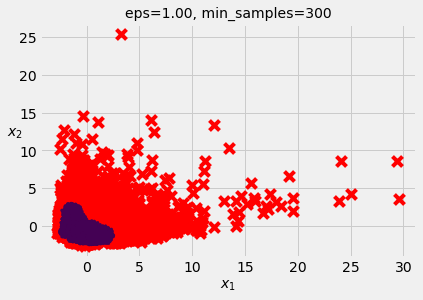

In [28]:
plot_dbscan(dbs,df_2D,size=10)
print(dbs.labels_)

In [29]:
# score default modelling
silhouette_score(df_2D, dbs.labels_)

0.2874796719812149

Hasil plot DBSCAN menunjukkan bahwa DBSCAN membagi data menjadi 2 cluster. Dengan silhouette score 0.28.

## Agglomerative Clustering

<AxesSubplot:>

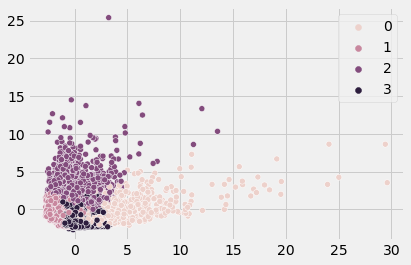

In [30]:
sns.scatterplot(x=df_2D[:,0],y=df_2D[:,1],hue=agg.labels_)

Hasil plot Agglomerative CLustering dengan n_clusters=4 (sama dengan PCA)

In [31]:
# score default modelling
silhouette_score(df_2D, agg.labels_)

0.2668574432130638

Text(0, 0.5, 'AGG Silhouette Score')

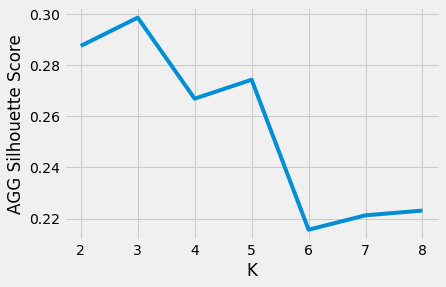

In [32]:
K = [2,3,4,5,6,7,8]

agg_score=[silhouette_score(df_2D, AC(n_clusters=i, linkage="ward").fit(df_2D).labels_) for i in K]
plt.plot(K, agg_score)
plt.xlabel('K')
plt.ylabel('AGG Silhouette Score')

Dengan Agglomerative Clustering hasil dari PCA cluster yang dibuat sebanyak 4 cluster. Namun ternyata berdasarkan silhouette score, jumlah cluster terbaik adalah 2 dengan skor 0.29

0.29851493813069957


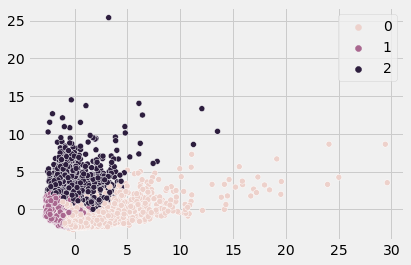

In [33]:
# new agglomerative clustering with n_clusters=2

agg_new = AC(n_clusters=3, linkage="ward").fit(df_2D)
sns.scatterplot(x=df_2D[:,0],y=df_2D[:,1],hue=agg_new.labels_)
print(silhouette_score(df_2D, agg_new.labels_))

# Model Inference

## K-Means

In [34]:
kmeans.predict(df_2D)

array([0, 3, 1, ..., 1, 0, 0])

In [35]:
# predict with standardized data
kmeans.predict(num_df_std[:,:4])

array([0, 1, 1, ..., 0, 0, 0])

In [36]:
# n_clusters berdasarkan hasil silhouette score
kmeans_new = KMeans(n_clusters=3, random_state=42)
kmeans_new.fit(df_2D)

KMeans(n_clusters=3, random_state=42)

In [37]:
rawdf['cluster_id'] = kmeans_new.labels_

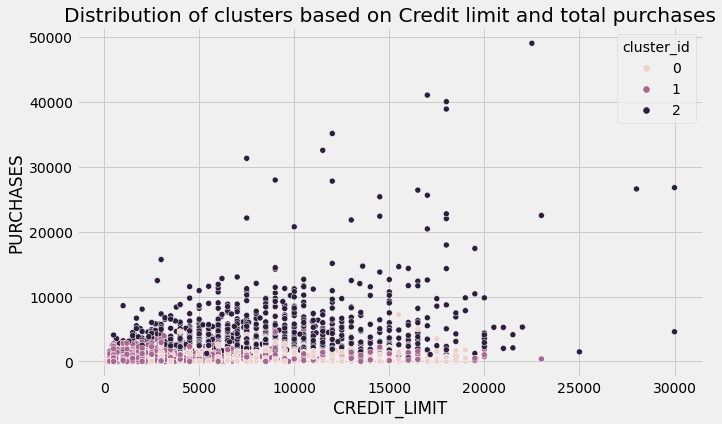

In [38]:
plt.figure(figsize=(10,6))
sns.scatterplot(data=rawdf, x='CREDIT_LIMIT', y='PURCHASES', hue='cluster_id')
plt.title('Distribution of clusters based on Credit limit and total purchases')
plt.show()

## DBScan

In [39]:
dbs.fit_predict(df_2D)

array([ 0,  0,  0, ..., -1, -1, -1], dtype=int64)

In [40]:
# predict with standardized data
dbs.fit_predict(num_df_std)

array([ 0, -1, -1, ..., -1, -1, -1], dtype=int64)

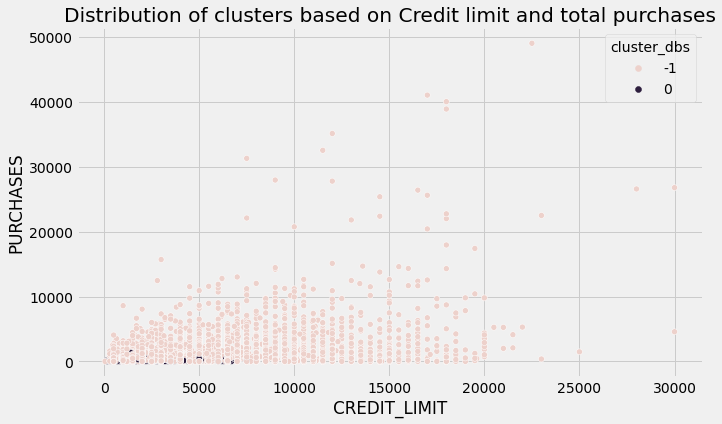

In [41]:
rawdf['cluster_dbs'] = dbs.labels_

plt.figure(figsize=(10,6))
sns.scatterplot(data=rawdf, x='CREDIT_LIMIT', y='PURCHASES', hue='cluster_dbs')
plt.title('Distribution of clusters based on Credit limit and total purchases')
plt.show()

## Agglomerative Clustering

In [42]:
agg_new.fit_predict(df_2D)

array([1, 2, 1, ..., 0, 1, 1], dtype=int64)

In [43]:
# predict with standardized data
agg_new.fit_predict(num_df_std)

array([1, 2, 0, ..., 1, 1, 1], dtype=int64)

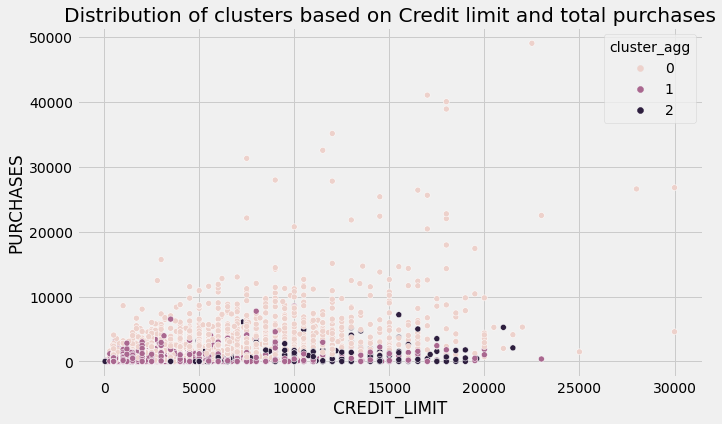

In [44]:
rawdf['cluster_agg'] = agg_new.labels_

plt.figure(figsize=(10,6))
sns.scatterplot(data=rawdf, x='CREDIT_LIMIT', y='PURCHASES', hue='cluster_agg')
plt.title('Distribution of clusters based on Credit limit and total purchases')
plt.show()

# Conclusion

## EDA Analysis

- Dari hasil histplot dataset, dapat terlihat bahwa banyak dari distribusi data yang tidak normal atau *skewed* dan rata-rata *skewed* ke kanan. Ini dapat dimaklumi dari kumpulan data seperti ini karena akan selalu ada beberapa pelanggan/nasabah yang melakukan jumlah transaksi yang sangat tinggi. Antara lain :
    - Pada kolom Credit_Limit, Payments, dan Minimum_Payments distribusi data tertarik ke kanan karena ada pelanggan yang memiliki kredit limit dan jumlah pembayaran yang tinggi.
    - Hal yang sama juga terjadi pada kolom Purchases dan Installment Purchases. Dan dapat dilihat juga di kolom Balance Frequency, rata-rata nilai datanya ada pada angka 1 yakni menunjukkan bahwa akun-akun nasabah masih banyak yang aktif karena terdeteksi seringnya pembaruan(update) saldo.

- Rata-rata mayoritas nasabah memilih jangka waktu tenor kredit yang paling panjang yakni 12. Dengan jangka waktu paling rendah yakni 9.
- Visualisasi Heatmap menunjukkan korelasi antar kolom pada dataset. Saat nilai korelasi positif dan > 0.5 maka jika salah satu kolom nilainya naik kolom yang berkorelasi dengannya pun ikut naik. Sebagai contoh dari heatmap ini adalah kolom Purchase. Kolom Purchase memliki nilai korelasi positif > 0.5 pada beberapa kolom yakni oneoff_purchases, installment_purchases, oneoff_purchases_frequency, purchases_trx dan payments. Sehingga jika nilai kolom Purchases naik maka nilai kolom-kolom tersebut juga naik.

## Model Analysis

Masing-masing model memiliki kelebihan dan kekurangannya masing-masing.
- K-Means = Dapat memisahkan data menjadi beberapa cluster sesuai yang kita inginkan. Disini jumlah cluster yang ingin kita gunakan berdasarkan PCA adalah 4. Namun berdasarkan perhitungan silhouette score, jumlah cluster optimum adalah 3 dengan nilai 0.34
- DBSCAN = Mengelompokkan data menjadi cluster-cluster sesuai dengan parameter yang diatur pengguna (epsilon dan min_samples). Dikarenakan DBSCAN membaca berdasarkan *density* atau kerapatan data maka kita tidak dapat menyatakan berapa cluster yang diinginkan, karena telah diatur otomatis oleh DBSCAN. Data yang dipakai kali ini memiliki kerapatan data yang cukup padat, sehingga untuk mendapatkan hasil terbaik diperlukan tuning paramater yang tepat.
- Agglomerative Clustering = Model ini kurang lebih mirip dengan K-Means. Hasil skor silhouette menunjukkan bahwa jumlah cluster optimum adalah 3 cluster dengan skor 0.29


Pada Model Inference dapat terlihat bahwa K-Means dan Agglomerative CLustering dapat mengelompokkan data dengan cukup baik ke beberapa cluster. Sehingga kita dapat secara kasar menyimpulkan bahwa Cluster 2 pada hasil K-Means menunjukkan kumpulan nasabah yang dengan transaksi besar karena seiring credit_limitnya makin besar maka kemampuan membelinya (Purchase) semakin besar juga. Hal yang sama juga terjadi dengan Cluster 0 pada Agglomerative CLustering.

Namun untuk DBSCAN tidak dapat mengelompokkan data dengan cukup baik. Mungkin dikarenakan parameter yang tidak cocok sehingga perlu untuk disesuaikan lagi sampai mendekati hasil model lainnya.


**Sehingga, berdasarkan silhouette score, penulis menyatakan bahwa K-Means menjadi model yang paling cocok untuk dataset ini.**